# Range test analysis

Analysis of acoustic tracking performance using range test data obtained in Mahone Bay near Halifax, NS, by OTN field experiments during March-April 2016.

Components of this notebook:

 * load detection events and deployment metadata about receivers and transmitters
 * analyse detections for each receiver/transmitter combination separately
 * calculate interval lengths between detections and detection rates within fixed time windows
 * calculate further metadata descriptions, e.g. distance between stations, R/T names involving distinctions such as near/far distance or high/low power
 * process tidal data for the time period considering high/low tide times and the observed heights, calculate tidal phase and height change for each detection timestamp via cosine interpolation of heights
 * obtain further environmental variables from external data sources
 * produce different visualizations to study correlation of env. variables and operating conditions with detection rate

**Data:** For most sources for environmental variables data has been collected for 3 hour intervals.

See [installation instructions](../docs/install.md) on how to run this notebook.

In [1]:
import range_driver as rd
    
import pandas as pd
%matplotlib inline
rd.mpl_set_notebook_params()

## Obtain configuration from YAML files

In [2]:
baseconfig = rd.yload(rd.load_file("configs/base_config.yaml"))
viewconfig = rd.yload(rd.load_file("configs/view_config.yaml"))
rd.deep_update(baseconfig, viewconfig)

rawconfig = rd.yload(rd.load_file("configs/mahone_config.yaml"))
config = rd.merge_dicts(baseconfig, rawconfig)

rd.prepare_config(config)

# Set the kadlu storage location to point to cached data
import kadlu
kadlu.storage_cfg(setdir=f'{rd.utils.repo_path()}/data/MahoneBay2016/kadlu_data/')

/home/runner/work/range-driver/range-driver/data/MahoneBay2016/kadlu_data/

## Read Detections, Metadata, and Environmental Variables

In [3]:
dets = rd.Detections(config)

## Detail Reports

# Detection rate plots for data screening

### VMT-1188739/tag-31335-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VMT-1188739,A69-1601-31335,2016-03-09 15:59:51,2016-04-04 20:51:26,2308,263.0,39764.0,VMT-1188739/tag-31335-F-H,822.11224,V16-5x,31335,H,5,5,5.0


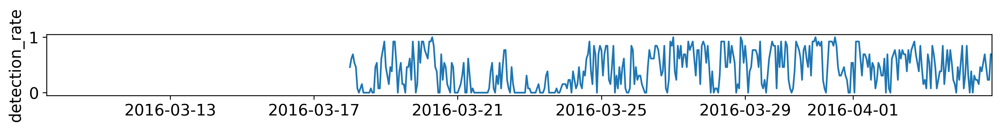

### VR2W-100928/tag-31335-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-100928,A69-1601-31335,2016-03-17 14:48:17,2016-04-04 17:46:12,4167,263.0,8026.0,VR2W-100928/tag-31335-F-H,822.11224,V16-5x,31335,H,5,5,5.0


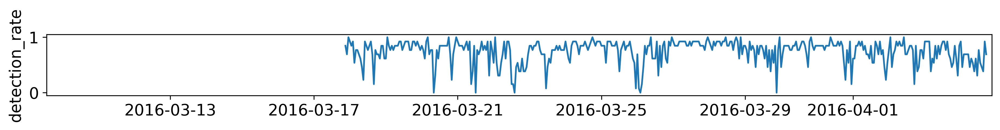

### VR2W-128559/tag-31335-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-128559,A69-1601-31335,2016-03-17 14:48:08,2016-04-04 17:45:36,3710,263.0,9684.0,VR2W-128559/tag-31335-F-H,822.11224,V16-5x,31335,H,5,5,5.0


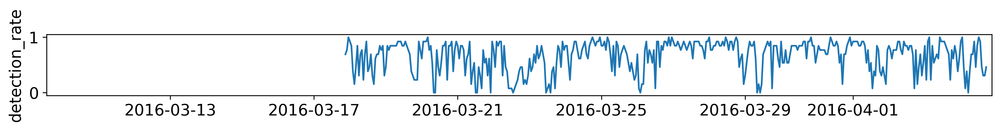

### VR4-UWM-250473/tag-31335-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR4-UWM-250473,A69-1601-31335,2016-03-17 14:48:21,2016-04-04 17:51:30,2866,263.0,7320.0,VR4-UWM-250473/tag-31335-F-H,822.11224,V16-5x,31335,H,5,5,5.0


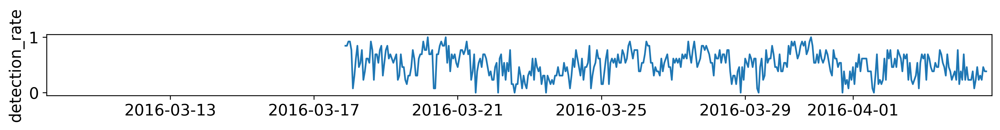

### VMT-1188739/tag-31339-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VMT-1188739,A69-1601-31339,2016-03-17 19:02:43,2016-04-04 16:48:31,80,276.0,789759.0,VMT-1188739/tag-31339-F-H,822.11224,V13-1x,31339,H,5,5,5.0


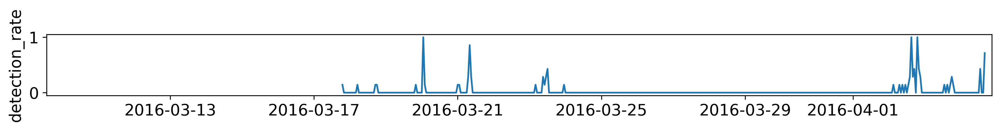

### VR2W-100928/tag-31339-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-100928,A69-1601-31339,2016-03-17 14:49:52,2016-04-04 17:45:12,1214,32.0,370290.0,VR2W-100928/tag-31339-F-H,822.11224,V13-1x,31339,H,5,5,5.0


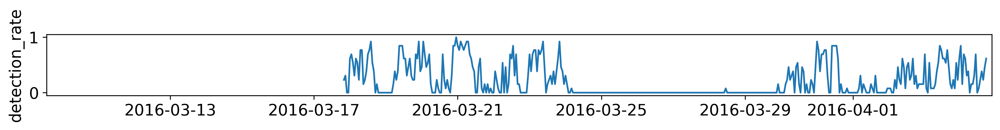

### VR2W-128559/tag-31339-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-128559,A69-1601-31339,2016-03-17 14:53:55,2016-04-04 17:39:49,555,263.0,521763.0,VR2W-128559/tag-31339-F-H,822.11224,V13-1x,31339,H,5,5,5.0


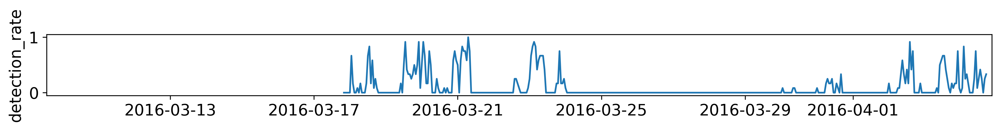

### VR4-UWM-250473/tag-31339-F-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR4-UWM-250473,A69-1601-31339,2016-03-17 14:57:49,2016-04-04 17:40:12,585,263.0,439208.0,VR4-UWM-250473/tag-31339-F-H,822.11224,V13-1x,31339,H,5,5,5.0


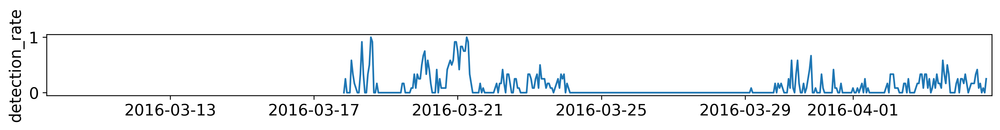

### VMT-1188739/tag-31340-N-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VMT-1188739,A69-1601-31340,2016-03-09 19:24:44,2016-04-04 20:51:44,4379,263.0,29890.0,VMT-1188739/tag-31340-N-H,520.35822,V13-1x,31340,H,260,340,300.0


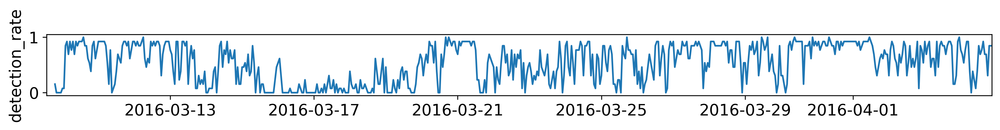

### VR2W-100928/tag-31340-N-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-100928,A69-1601-31340,2016-03-09 18:02:47,2016-04-04 17:52:01,6754,263.0,8438.0,VR2W-100928/tag-31340-N-H,520.35822,V13-1x,31340,H,260,340,300.0


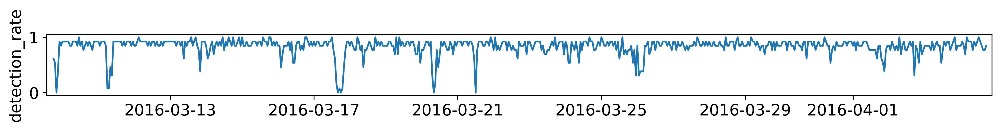

### VR2W-128559/tag-31340-N-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-128559,A69-1601-31340,2016-03-09 18:02:49,2016-04-04 17:51:25,6488,263.0,9438.0,VR2W-128559/tag-31340-N-H,520.35822,V13-1x,31340,H,260,340,300.0


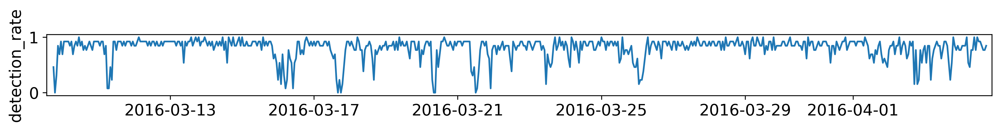

### VR4-UWM-250473/tag-31340-N-H

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR4-UWM-250473,A69-1601-31340,2016-03-09 18:02:48,2016-04-04 17:51:48,4275,263.0,14553.0,VR4-UWM-250473/tag-31340-N-H,520.35822,V13-1x,31340,H,260,340,300.0


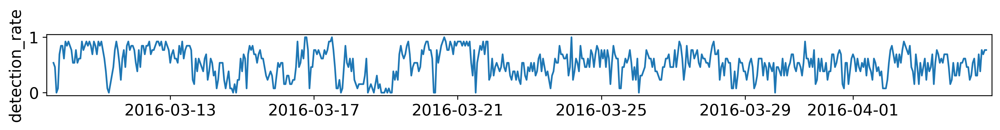

### VMT-1188739/tag-31341-N-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VMT-1188739,A69-1601-31341,2016-03-09 16:25:31,2016-04-03 02:03:14,75,264.0,323765.0,VMT-1188739/tag-31341-N-L,520.35822,V9-2x,31341,L,5,5,5.0


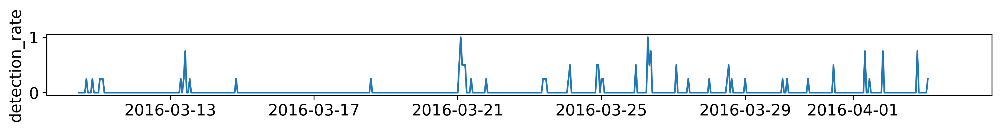

### VR2W-100928/tag-31341-N-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-100928,A69-1601-31341,2016-03-09 13:25:33,2016-04-04 17:04:53,5098,264.0,20264.0,VR2W-100928/tag-31341-N-L,520.35822,V9-2x,31341,L,5,5,5.0


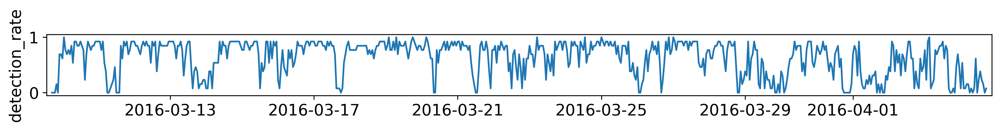

### VR2W-128559/tag-31341-N-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-128559,A69-1601-31341,2016-03-09 13:25:35,2016-04-04 17:45:50,3978,263.0,43082.0,VR2W-128559/tag-31341-N-L,520.35822,V9-2x,31341,L,5,5,5.0


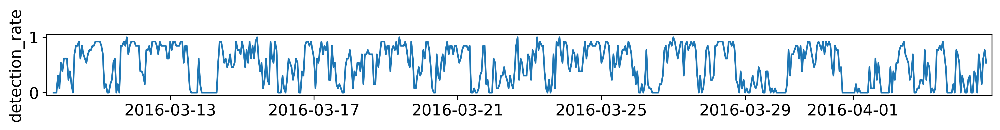

### VR4-UWM-250473/tag-31341-N-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR4-UWM-250473,A69-1601-31341,2016-03-09 13:25:33,2016-04-04 17:41:01,2286,264.0,43120.0,VR4-UWM-250473/tag-31341-N-L,520.35822,V9-2x,31341,L,5,5,5.0


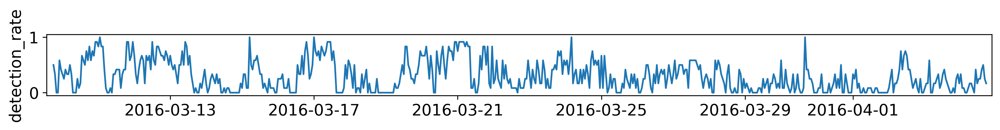

### VR2W-100928/tag-31342-U-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-100928,A69-1601-31342,2016-03-17 17:48:02,2016-04-02 16:24:50,43,273.0,423850.0,VR2W-100928/tag-31342-U-L,NaN,V9-2x,31342,L,260,340,300.0


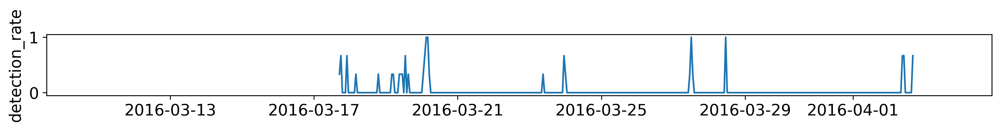

### VR2W-128559/tag-31342-U-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR2W-128559,A69-1601-31342,2016-03-17 16:22:33,2016-04-02 16:24:17,5,1138.0,1369251.0,VR2W-128559/tag-31342-U-L,NaN,V9-2x,31342,L,260,340,300.0


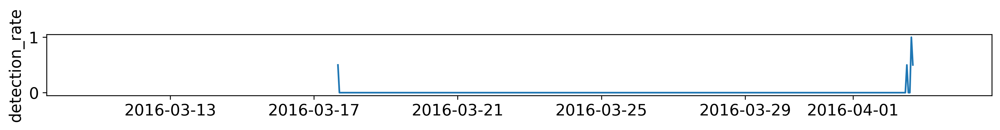

### VR4-UWM-250473/tag-31342-U-L

,,tstart,tend,count,min_interval,max_interval,Receiver/Transmitter,dist_m,Transmitter.Tag Family,Transmitter.ID,Transmitter.Power,Transmitter.Min delay,Transmitter.Max delay,Transmitter.Avg delay
VR4-UWM-250473,A69-1601-31342,2016-03-17 16:23:02,2016-04-03 15:36:19,40,276.0,412585.0,VR4-UWM-250473/tag-31342-U-L,NaN,V9-2x,31342,L,260,340,300.0


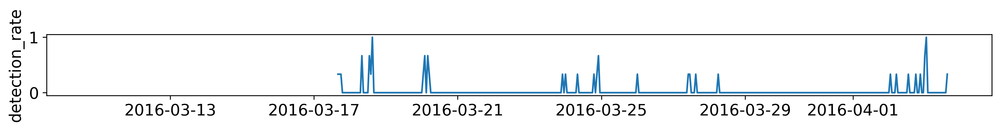

In [4]:
rd.report_group_info(dets)
rd.report_tidal(dets)

### Data Sources

In [5]:
print(rd.kadlu_source_map())
print("Configured data sources:\n")
print(rd.ydump(config.data.sources))


    CHS   (Canadian Hydrography Service)
          bathymetry:       bathymetric data in Canada's waterways. metres, variable resolution 

    ERA5  (Global environmental dataset from Copernicus Climate Data Store)
          wavedir:          mean wave direction, degrees
          waveheight:       combined height of wind, waves, and swell. metres
          waveperiod:       mean wave period, seconds
          wind_uv:          wind speed computed as sqrt(u^2 + v^2) / 2, where u, v are direction vectors
          wind_u:           wind speed coordinate U-vector, m/s
          wind_v:           wind speed coordinate V-vector, m/s 

    GEBCO (General Bathymetric Chart of the Oceans)
          bathymetry:       global bathymetric and topographic data. metres below sea level 

    HYCOM (Hybrid Coordinate Ocean Model)
          salinity:         g/kg salt in water
          temp:             degrees celsius
          water_uv:         ocean current computed as sqrt(u^2 + v^2) / 2, where 

## Maps visualization
Map view including region of interest bound, environmental data source nodes, receiver and tag locations.

In [6]:
rd.report_map_view(dets)

Map(center=[44.1541333, -64.17682], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title'…

In [7]:
# --------------------- Detail plots ------------------------
columns, colnames, column = rd.get_column_info(config)
rd.displaymd("## Plots of detection density and interval lengths <br/> against tidal phase (t2) and {}".format(colnames[column]))

## Plots of detection density and interval lengths <br/> against tidal phase (t2) and water velocity

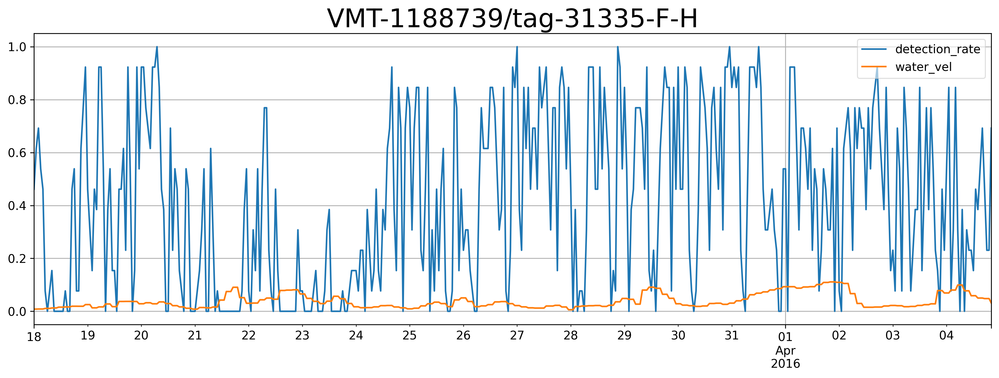

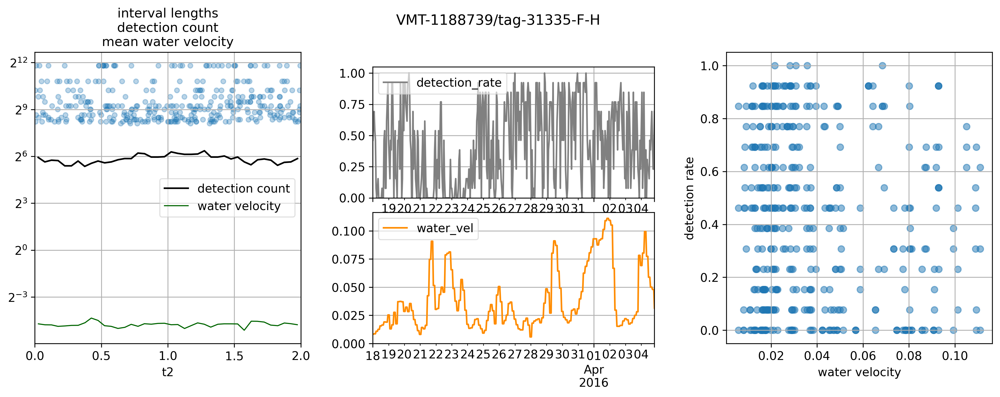

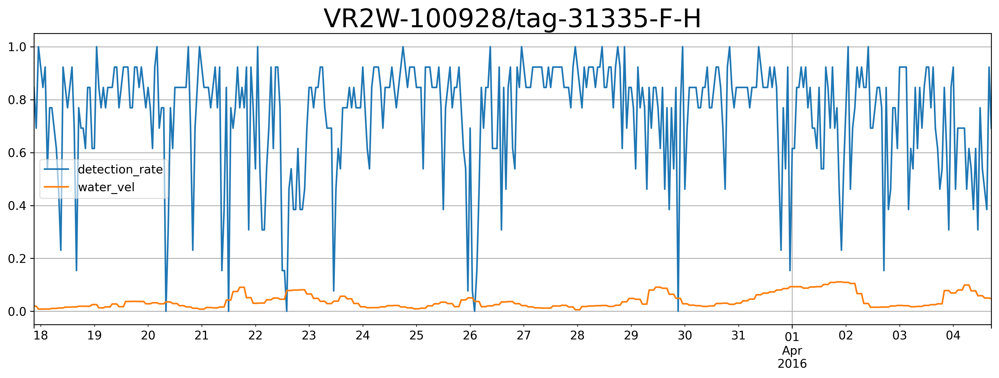

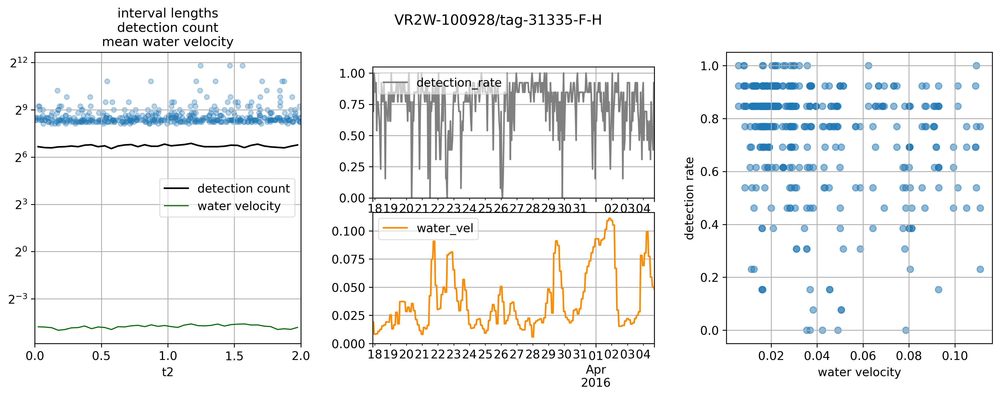

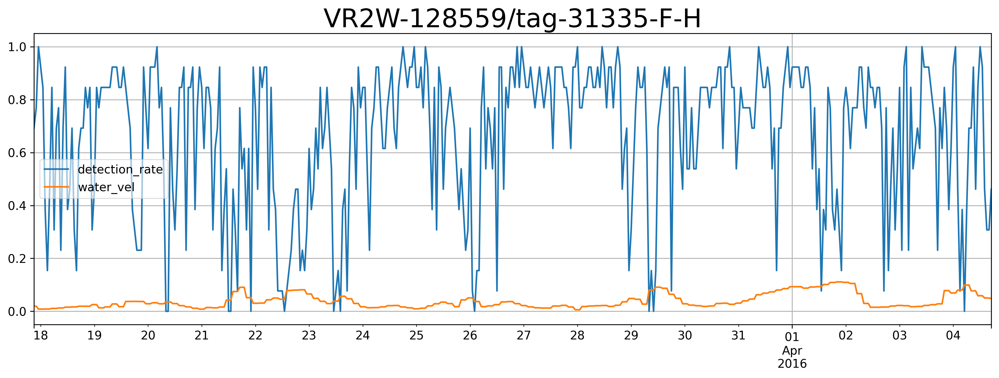

...

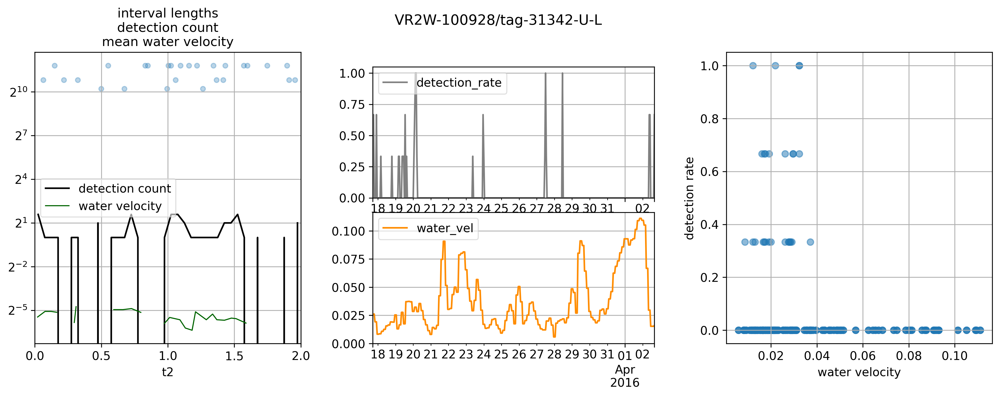

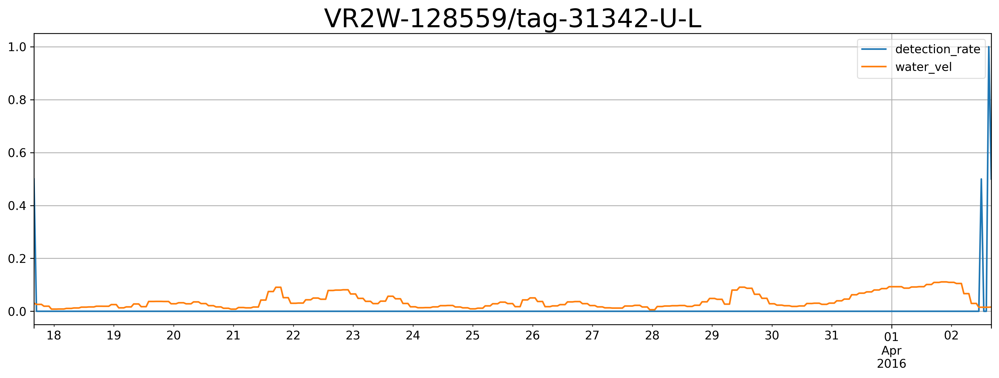

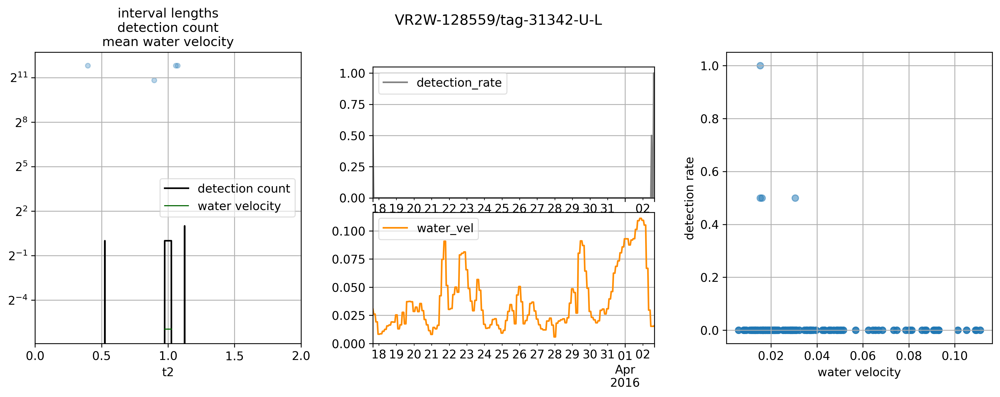

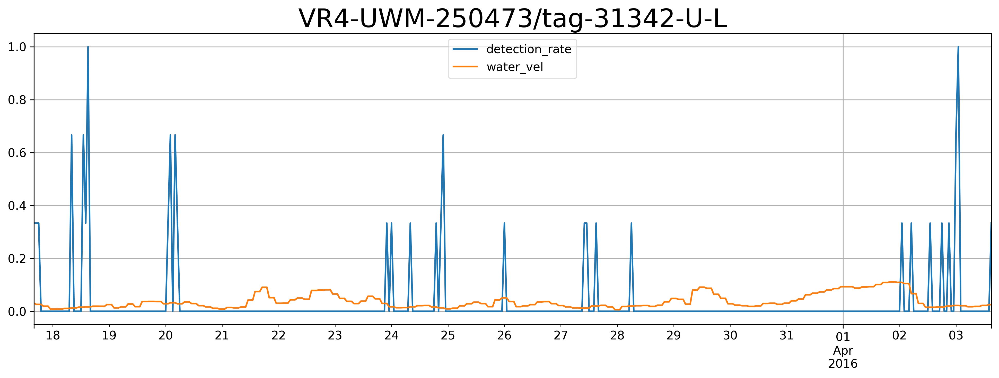

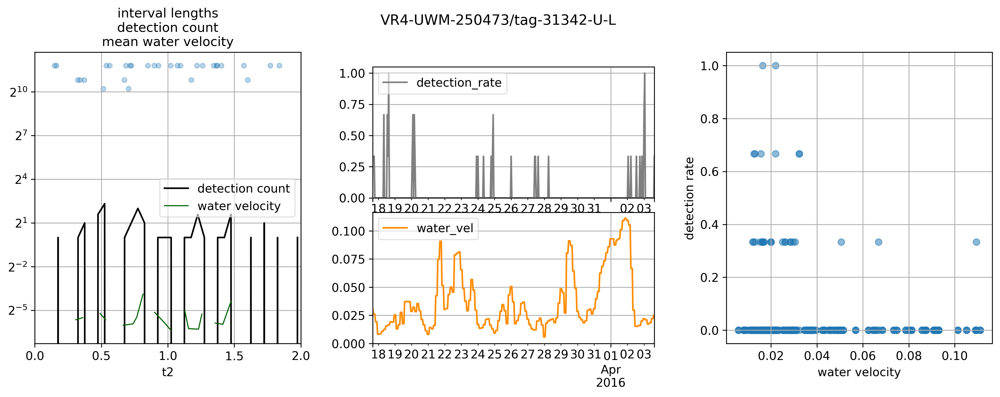

In [8]:
rd.report_all_group_plots(dets)

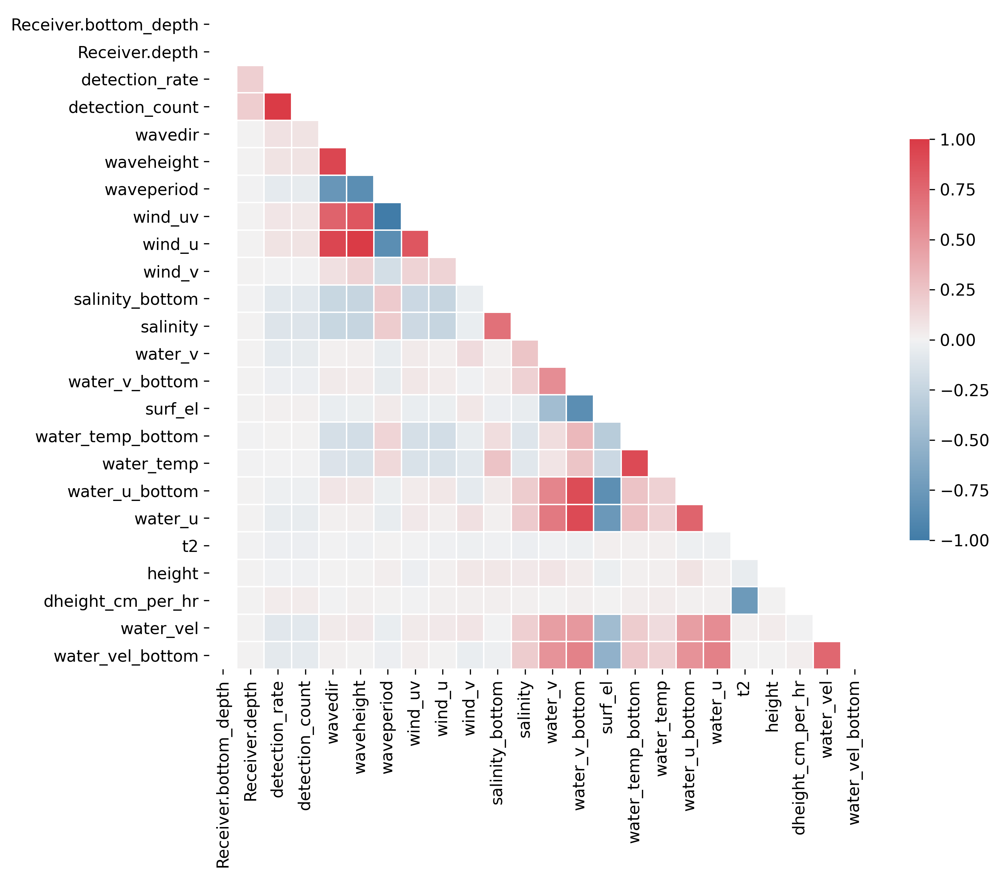

In [9]:
rd.report_heatmap(dets)

# Discussion

In the above visual summary, the **H-N** combinations, i.e. high-power, near distance, are the ones where water velocity shows the least effect on variations in detection rate. This confirms expectations and shows promise for the proposed study method. Next steps include:

- Continue to work with detection rate (DR) as calculated in a fixed grid of time windows
- Compare variations of DR with respect to other environmental variables
- Import other environmental variables automatically via data source APIs (ERDDAP, kadlu.fetch)
- Compare different scenarios of factor importance depending on environmental setting of the study 


# Acknowledgements

The above analysis was performed using [data from OTN](http://members.devel.oceantrack.org/erddap/tabledap/otnunit_aat_detections.html) (provided by Jonathan Pye of OTN), in combination with HYCOM environmental data and tidal data provided by Casey Hilliard (Meridian/Dal), with a synthesized dataset prepared by Matthew Berkowitz (SFU), with project definition and guidance provided by Oliver Kirsebom (Dal) and Ines Hessler (Dal) as part of the [Meridian Network](https://meridian.cs.dal.ca).